# Source 
https://www.youtube.com/watch?v=a339Q5F48UQ

In [3]:
#Array packages
import pandas as pd
import numpy as np
import xarray as xr
import netCDF4 as nc4
from dask.distributed import Client

from scipy.stats import kendalltau
import pymannkendall as mk

#plots
import matplotlib.pyplot as plt
import rioxarray as rio
import geopandas as gpd
from shapely.geometry import mapping

#Progress meter
from dask.diagnostics import ProgressBar
from tqdm import tqdm

# Directories
import os
import glob
import dask
#import h5netcdf
import scipy


In [4]:
print(os.getcwd())
os.chdir("..")        #os.chdir(r"E:\academy\3. IIT DELHI\2. Academics\1_PAPER\2_Analysis")

E:\academy\3. IIT DELHI\2. Academics\1_PAPER\2_Analysis\2_Preliminary analysis


# 1.Preprocessing

In [11]:
#2. Loading LIS output
lsm_M= xr.open_mfdataset('DATA_p/1_LIS_1980_2021_M.nc')
lsm_M=lsm_M*60*60*24*30 #converting to mm/ month

# 3_Teleconnection

In [5]:
# Loading climatic oscillation
CO=pd.read_csv('input/Climate_oscillation/COs.csv')

CO['DATE'] = pd.to_datetime(CO.DATE,format='%d-%m-%Y')
CO.set_index('DATE', inplace=True)
enso = CO.loc[lsm_M.time][['ENSO','ENSO_phase']]

xr_enso=xr.DataArray(np.array(enso["ENSO"]),coords=[lsm_M.time.values],dims=["time"])

# variable
ds_r=lsm_M['TotalPrecip_tavg']
ds_Q=lsm_M['Qs_tavg']

#ds1=lsm_M['TotalPrecip_tavg']/lsm_M['Qs_tavg']
#ds=ds1.where(ds1<1)


## 3_1 Correlation analysis

[12, 1, 2, 3, 4]

### a) PPT

In [21]:
tele_PPT=xr.corr(lsm_M['TotalPrecip_tavg'], xr_enso, dim='time')
Map_plot(tele_PPT,-0.4,0.4,"PREC VS ENSO","Correlation")
plt.savefig("output/PREC_ENSO_Correlation.png")

C:\Users\sstar\AppData\Local\Temp\ipykernel_23204\1312124013.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


### b)_Std ppt

In [6]:
lsm_monthly  =  lsm_M['TotalPrecip_tavg'].groupby('time.month')
lsm_mean     =  lsm_M['TotalPrecip_tavg'].groupby('time.month').mean(dim='time')

lsm_anom = lsm_monthly-lsm_mean  

lsm_std = lsm_M['TotalPrecip_tavg'].groupby('time.month').std(dim='time')

lsm_norm= (lsm_anom.groupby('time.month'))/lsm_std

C:\Users\sstar\AppData\Local\Temp\ipykernel_23204\1312124013.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


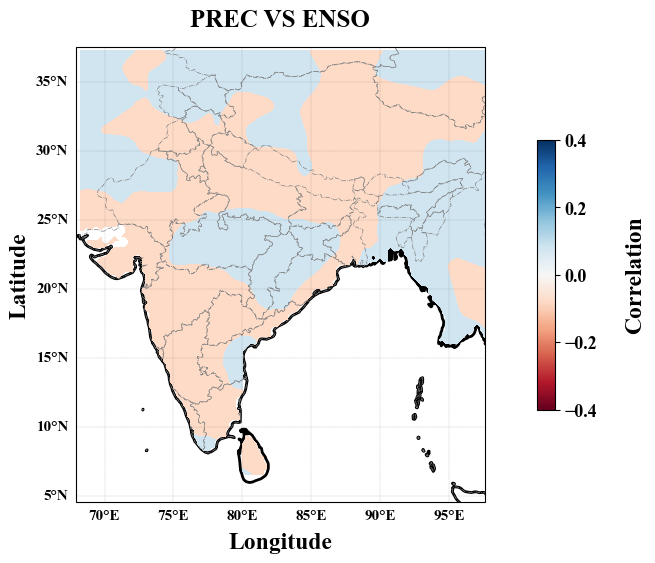

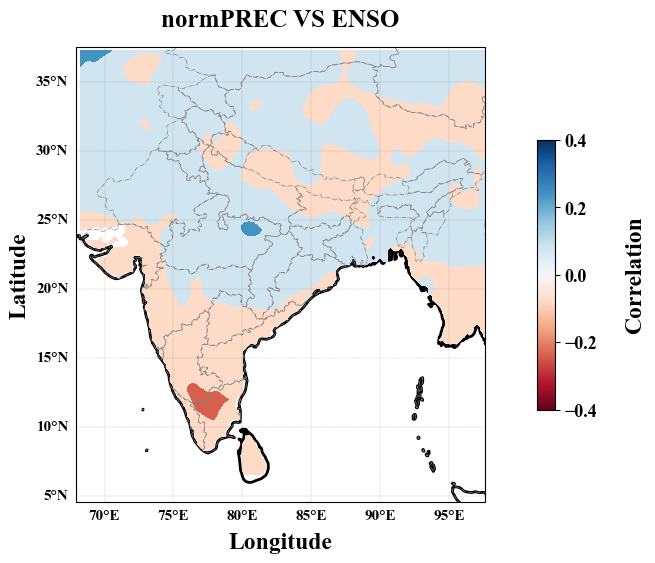

In [23]:
corr_PPT=xr.corr(lsm_norm, xr_enso, dim='time')
Map_plot(corr_PPT,-0.4,0.4,"normPREC VS ENSO","Correlation")
plt.savefig("output/normPREC_ENSO_Correlation.png")
plt.show()

## 3_2 Phase analysis

In [7]:
#2. Loading LIS output
lsm_M= xr.open_dataset('input/MERRA2_LIS/LIS_1980_2021_M.nc')
lsm_M=lsm_M*60*60*24*30 #converting to mm/ month
lsm_M=lsm_M[['TotalPrecip_tavg','Qs_tavg','RE']]

RE1=lsm_M['Qs_tavg']/lsm_M['TotalPrecip_tavg']
RE=RE1.where(RE1<1)
lsm_M['RE']=RE


lsm_monthly  =  lsm_M.groupby('time.month')
lsm_mean     =  lsm_M.groupby('time.month').mean(dim='time')
lsm_anom = lsm_monthly-lsm_mean  
lsm_std  = lsm_M.groupby('time.month').std(dim='time')
lsm_norm = (lsm_anom.groupby('time.month'))/lsm_std

In [89]:
##el nino la nina
elnino=enso[enso["ENSO_phase"]=="EL NINO"].index
lanina=enso[enso["ENSO_phase"]=="LA NINA"].index



#Name format setting
nm_var=['TotalPrecip_tavg','Qs_tavg','RE']
nm_var1=['PPT','Qs','RE']
seas=['All','summer','winter']
seas_mth=[range(1,13),[6,7,8,9],[12,1,2,3,4]]

clab1=np.array([-2,2])
vmin=-.7
vmax=.7

In [70]:
def get_sub(x): 
    normal = "ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz0123456789+-=()"
    sub_s = "ₐ₈cdₑբGₕᵢⱼₖₗₘₙₒₚQᵣₛₜᵤᵥwₓᵧZₐ♭꜀ᑯₑբ₉ₕᵢⱼₖₗₘₙₒₚ૧ᵣₛₜᵤᵥwₓᵧ₂₀₁₂₃₄₅₆₇₈₉₊₋₌₍₎"
    res = x.maketrans(''.join(normal), ''.join(sub_s)) 
    return x.translate(res) 
  
# display subscript 
print('H{}SO{}'.format(get_sub('2'),get_sub('4'))) #H₂SO₄ 

H₂SO₄


In [87]:
print(f'H{get_sub("2")}SO{get_sub("4")}') 

H₂SO₄


'PPTₗₐ ₙᵢₙₐ-PPTₑₗ ₙᵢₙₒ'

In [80]:
print(f"nm_var[0]{}".format(get_sub('2')))

SyntaxError: f-string: empty expression not allowed (2947788934.py, line 1)

In [126]:
for vr in range(3):
    for ss in range(3):
        
        ds=lsm_norm[nm_var[vr]]
        
        time_sub=np.where(np.isin(np.array(lsm_M['time.month']),seas_mth[ss]))
        var_sub=ds.isel(time=time_sub[0])
        
        elnino1=elnino[elnino.month.isin(seas_mth[ss])]
        lanina1=lanina[lanina.month.isin(seas_mth[ss])]
        
        ppt_la=var_sub.sel(time=lanina1).mean(dim='time')
        ppt_el=var_sub.sel(time=elnino1).mean(dim='time')
        
        #vmin=(ppt_la-ppt_el).quantile(0.01)
        #vmax=(ppt_la-ppt_el).quantile(0.99)
        legnd=f"{nm_var1[0]}{get_sub('La Nina')} - {nm_var1[0]}{get_sub('El Nino')}"
        
        Map_plot(ppt_la-ppt_el,vmin,vmax,f"{nm_var1[vr]} ({seas[ss]})",legnd)
        plt.savefig(f"output/new/enso_la_{nm_var[vr]}_{seas[ss]}.png",bbox_inches='tight' )   
        
        #Map_plot(ppt_el,vmin,vmax,seas[ss],nm_var[vr])
        #plt.savefig(f"output/new/enso_el_{nm_var[vr]}_{seas[ss]}.png",bbox_inches='tight' )

C:\Users\sstar\AppData\Local\Temp\ipykernel_18652\165501704.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)
C:\Users\sstar\AppData\Local\Temp\ipykernel_18652\165501704.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)
C:\Users\sstar\AppData\Local\Temp\ipykernel_18652\165501704.py:55: MatplotlibDeprecationWarning: Unable to deter

### a) PPT

In [61]:
## Phase_analysis
elnino=enso[enso["ENSO_phase"]=="EL NINO"].index
lanina=enso[enso["ENSO_phase"]=="LA NINA"].index

#mths= np.append(np.arange(1, 4), np.arange(11, 13))
mths=np.arange(6, 10)

elnino1=elnino[elnino.month.isin(mths)]
lanina1=lanina[lanina.month.isin(mths)]

<xarray.DataArray 'RE' (lat: 320, lon: 300)>
array([[           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       [           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       [           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       ...,
       [ 4.7165077e-02, -5.9621409e-02,  6.1596800e-02, ...,
        -1.8304540e-04, -2.0059617e-04, -2.0472566e-04],
       [ 1.5302971e-02,  2.1722615e-02,  8.9770295e-02, ...,
         1.3392493e-03,  1.6553570e-03,  2.0220838e-03],
       [-5.7340041e-04, -4.9492121e-03, -2.9902592e-02, ...,
        -1.5566917e-04,  2.2793151e-03,  4.5238994e-06]], dtype=float32)
Coordinates:
  * lat      (lat) float64 5.55 5.65 5.75 5.85 5.95 ... 37.15 37.25 37.35 37.45
  * lon      (lon) float64 68.05 68.15 68.25 68.35 ... 97.65 97.75 97.85 97.95

C:\Users\sstar\AppData\Local\Temp\ipykernel_11400\3830374195.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


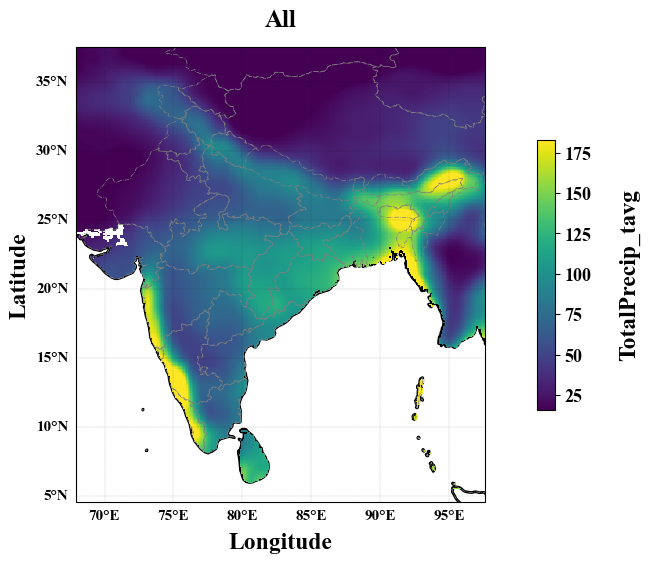

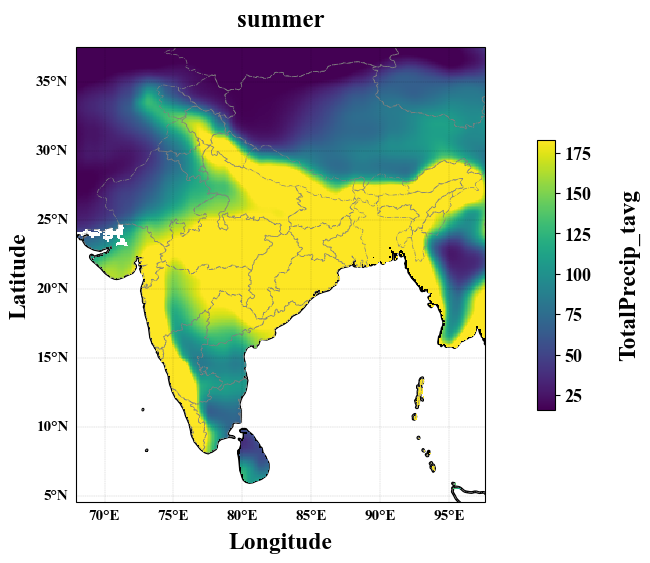

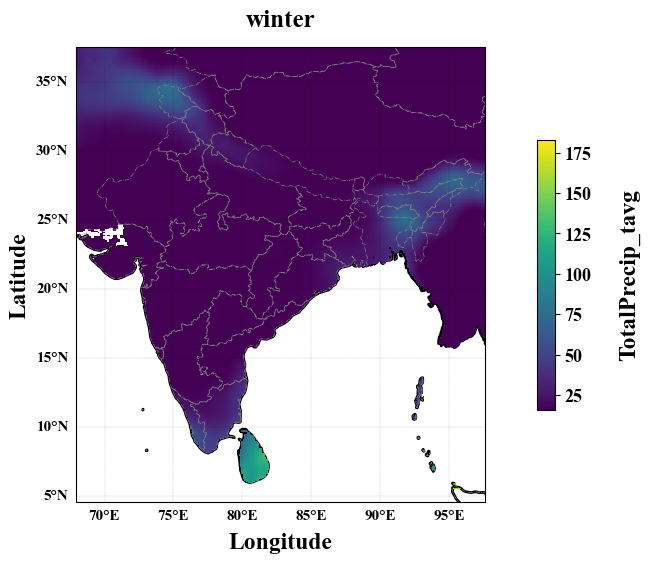

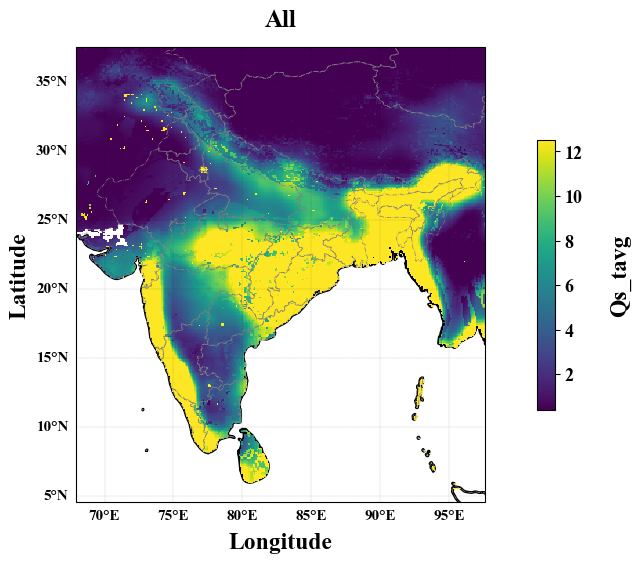

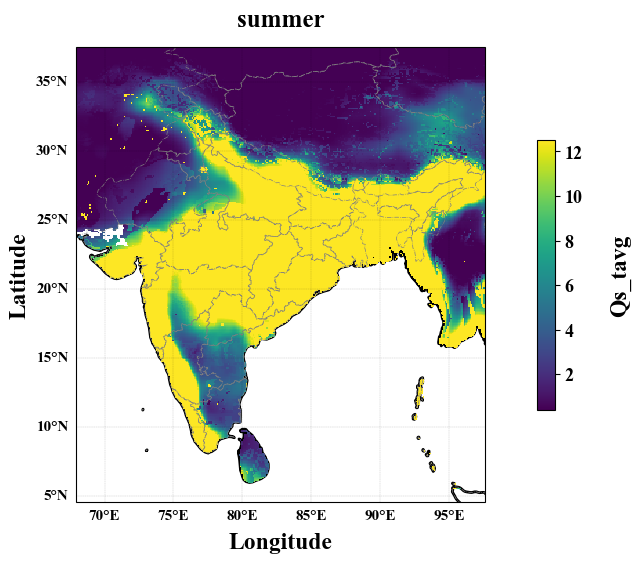

...

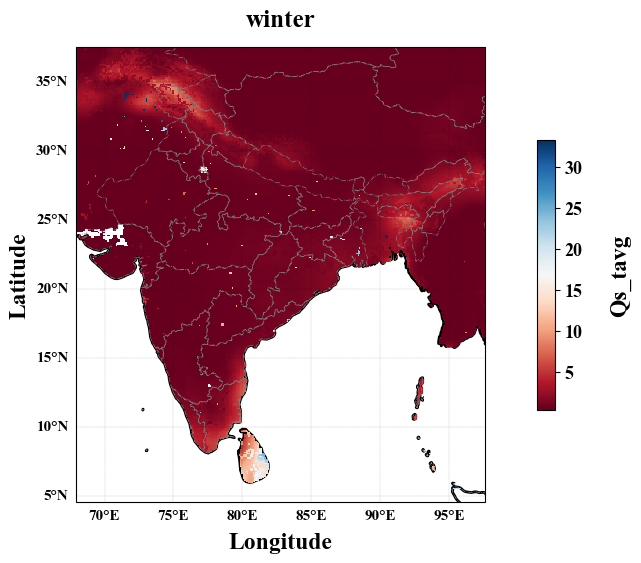

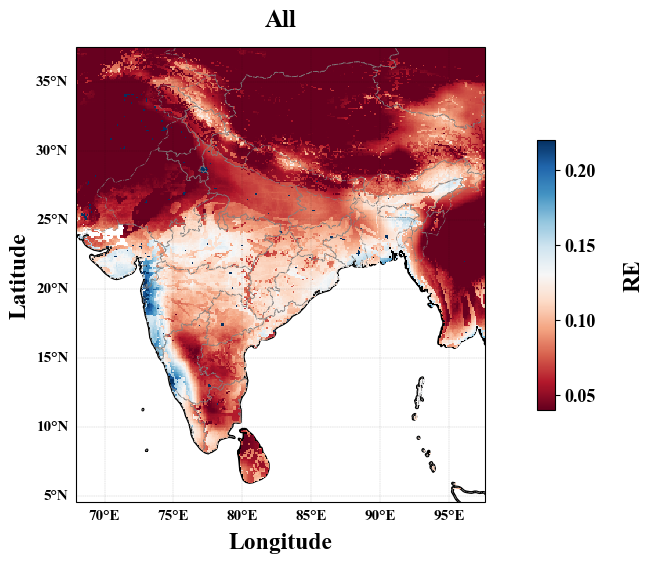

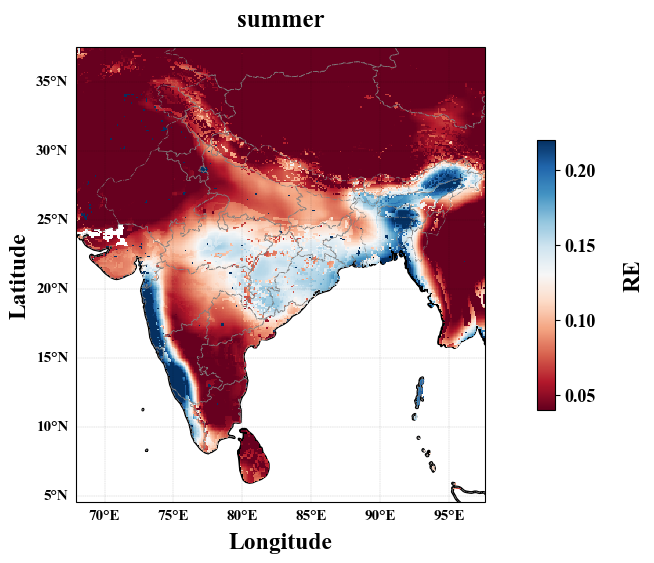

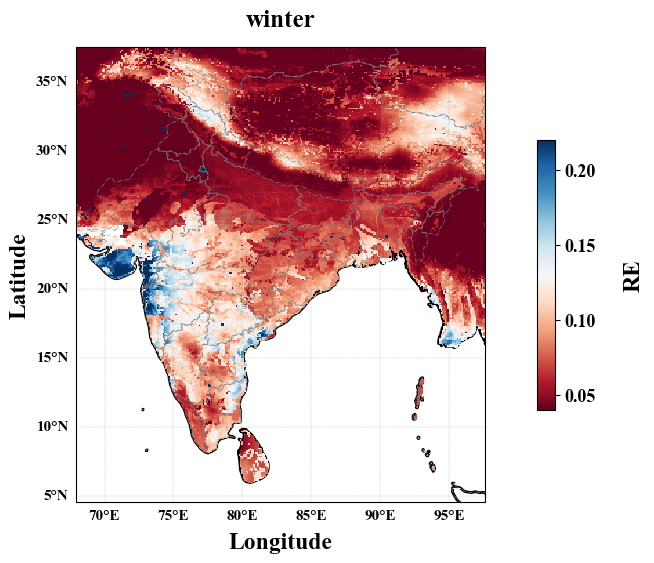

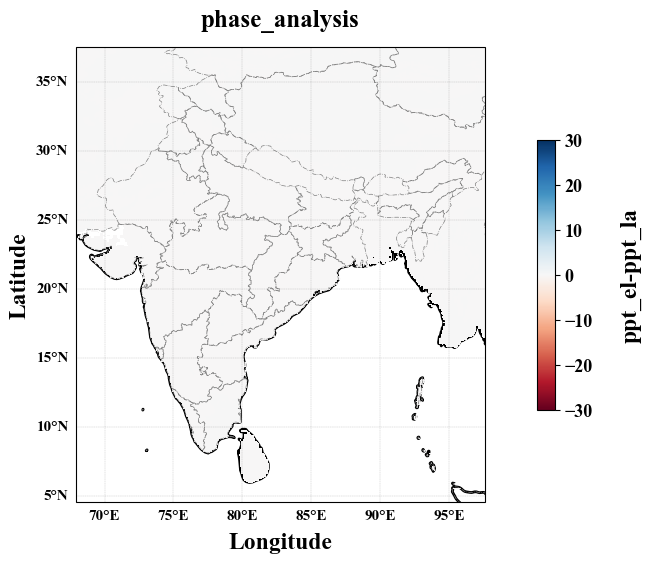

In [62]:
ppt=ds.mean(dim='time')
ppt_la=ds.sel(time=lanina1).mean(dim='time')
ppt_el=ds.sel(time=elnino1).mean(dim='time')

#ppt_la=lsm_norm.sel(time=lanina).mean(dim='time')
#ppt_el=lsm_norm.sel(time=elnino).mean(dim='time')


Map_plot(ppt_el-ppt_la,-30,30,"phase_analysis","ppt_el-ppt_la")
plt.savefig("output/PREC_ENSO_phaseanalysis.png")
plt.show()

### b)STD

In [29]:
## Phase_analysis
elnino=enso[enso["ENSO_phase"]=="EL NINO"].index
lanina=enso[enso["ENSO_phase"]=="LA NINA"].index

#mths= np.append(np.arange(1, 4), np.arange(11, 13))
mths=np.arange(1, 13)

elnino1=elnino[elnino.month.isin(mths)]
lanina1=lanina[lanina.month.isin(mths)]

C:\Users\sstar\AppData\Local\Temp\ipykernel_29528\1312124013.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


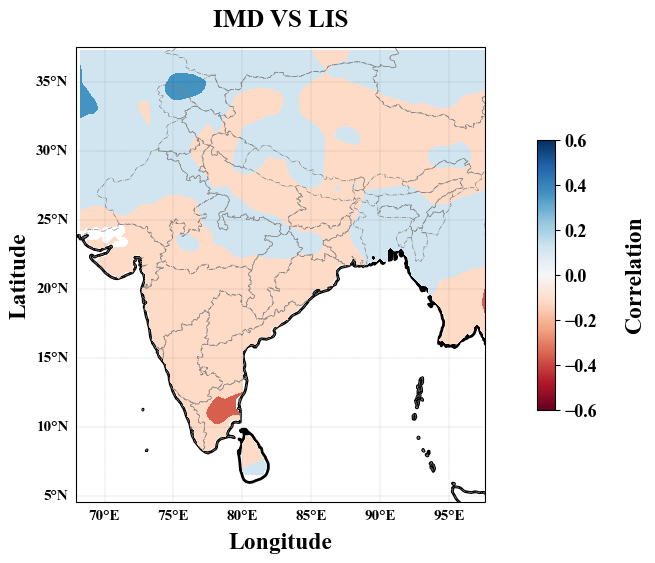

In [30]:

ppt_la=lsm_norm.sel(time=lanina1).mean(dim='time')
ppt_el=lsm_norm.sel(time=elnino1).mean(dim='time')

Map_plot(ppt_el,-.6,.6,"IMD VS LIS","Correlation")
plt.show()

C:\Users\sstar\AppData\Local\Temp\ipykernel_18312\1923471900.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


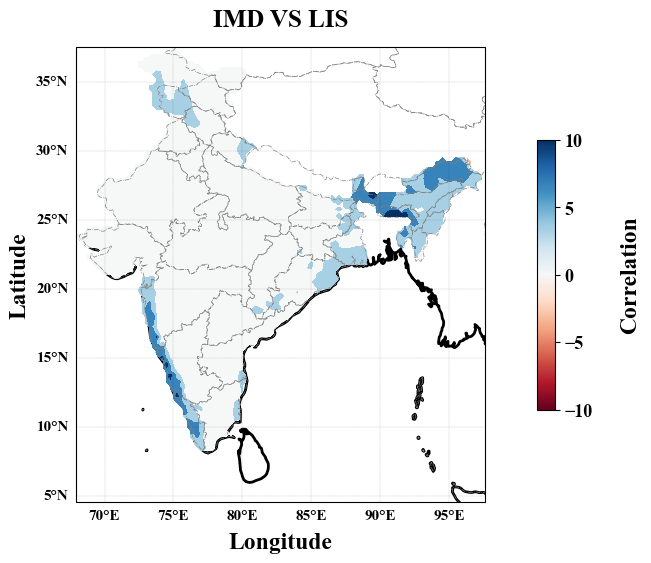

In [164]:
ppt_mean=imd_M['RAINFALL'].sel(time=lanina).mean(dim='time')
Map_plot(ppt_mean,-10,10,"IMD VS LIS","Correlation")

## 3_3 EVENT ANALYSIS

## 4.Correlation with frequency of PPT 

C:\Users\sstar\AppData\Local\Temp\ipykernel_21592\1923471900.py:55: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)


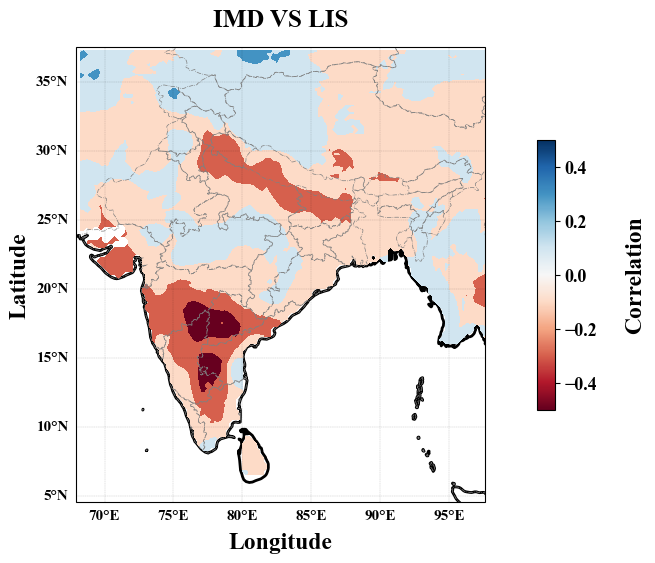

In [25]:
lsm_FM=lsm_M['Qs_tavg'].resample(time='6M').mean()
xr_enso_F=xr_enso.resample(time='6M').mean()

corr_ppt=xr.corr(xr_enso_F, lsm_FM, dim='time')
Map_plot(corr_ppt,-0.5,0.5,"IMD VS LIS","Correlation")

<xarray.DataArray (time: 504)>
array([ 0.55,  0.33,  0.09,  0.2 ,  0.13,  0.37,  0.02, -0.23, -0.12,
       -0.11,  0.1 ,  0.36, -0.45, -0.45, -0.02, -0.17, -0.11, -0.15,
       -0.43, -0.18, -0.07, -0.03, -0.27,  0.07, -0.04, -0.13, -0.02,
        0.24,  0.65,  0.92,  0.64,  0.93,  1.39,  2.  ,  2.07,  2.33,
        2.43,  2.22,  1.69,  1.12,  1.12,  0.62, -0.11, -0.13, -0.5 ,
       -1.03, -1.13, -0.95, -0.8 , -0.53, -0.48, -0.6 , -0.64, -0.9 ,
       -0.4 , -0.4 , -0.35, -0.83, -1.18, -1.53, -0.89, -0.91, -0.96,
       -0.98, -0.9 , -0.76, -0.61, -0.49, -0.57, -0.64, -0.43, -0.4 ,
       -0.79, -0.64, -0.51, -0.41, -0.47, -0.08,  0.16,  0.24,  0.59,
        0.9 ,  1.04,  0.98,  1.19,  1.17,  1.24,  0.89,  0.91,  1.24,
        1.34,  1.48,  1.53,  1.36,  1.29,  1.05,  0.69,  0.35,  0.29,
       -0.49, -1.05, -1.46, -1.54, -1.44, -1.33, -2.09, -2.18, -1.98,
       -1.95, -1.37, -1.33, -1.11, -0.8 , -0.64, -0.47, -0.58, -0.38,
       -0.4 , -0.3 , -0.13,  0.02,  0.36,  0.2 ,  0.26,  0.32,  0.  ,
        0.15,  0.17,  0.12,  0.13,  0.08,  0.32,  0.51,  0.32,  0.1 ,
        0.21,  0.44,  0.65,  0.62,  0.43,  0.22,  0.91,  1.14,  1.62,
        1.61,  1.62,  1.5 ,  1.41,  1.27,  0.53,  0.27, -0.15, -0.14,
       -0.35, -0.14,  0.04,  0.28,  0.42,  0.47,  0.92,  0.93,  0.64,
        0.33,  0.16,  0.26,  0.36,  0.28,  0.19,  0.03, -0.16, -0.06,
        0.03,  0.14,  0.27,  0.16,  0.52,  0.4 ,  0.9 ,  1.14,  1.21,
...
        0.59,  0.12, -0.15, -0.16, -0.39, -0.16, -0.37, -0.57, -1.04,
       -1.4 , -1.58, -1.61, -1.79, -1.7 , -1.17, -0.89, -0.64, -0.44,
       -0.04, -0.04, -0.28, -0.3 , -0.37, -0.9 , -1.  , -0.71, -0.72,
       -0.25,  0.17,  0.49,  0.69,  0.62,  0.68,  0.96,  1.49,  1.81,
        1.43,  1.18,  1.07,  0.56, -0.15, -0.62, -0.89, -1.33, -1.56,
       -1.65, -1.57, -1.63, -1.7 , -1.26, -0.98, -0.74, -0.53, -0.25,
       -0.23, -0.66, -0.76, -0.93, -1.09, -1.05, -0.93, -0.61, -0.48,
       -0.29, -0.18,  0.14,  0.44,  0.66,  0.44,  0.23,  0.33, -0.13,
       -0.42, -0.4 , -0.14, -0.08, -0.28, -0.33, -0.28, -0.29, -0.09,
       -0.24, -0.02, -0.09, -0.42, -0.45, -0.07,  0.28,  0.45,  0.48,
        0.13,  0.14,  0.37,  0.48,  0.89,  0.77,  0.59,  0.57,  0.48,
        0.9 ,  1.04,  1.28,  1.56,  1.87,  2.01,  2.21,  2.57,  2.56,
        2.56,  2.11,  1.6 ,  1.05,  0.45,  0.06, -0.25, -0.48, -0.46,
       -0.75, -0.63, -0.51, -0.34, -0.01, -0.09,  0.22,  0.3 ,  0.22,
        0.22, -0.18, -0.56, -0.52, -0.84, -0.85, -0.86, -0.73, -0.73,
       -0.36, -0.12,  0.12,  0.27,  0.05,  0.3 ,  0.84,  1.  ,  0.97,
        0.51,  0.62,  0.81,  0.67,  0.61,  0.66,  0.41,  0.19,  0.11,
        0.55,  0.74,  0.51,  0.64,  0.48,  0.36,  0.49, -0.12, -0.21,
       -0.04, -0.42, -0.66, -1.19, -1.01, -0.98, -1.04, -0.94, -0.72,
       -0.55, -0.41, -0.06, -0.2 , -0.38, -0.5 , -0.78, -0.88, -1.07])
Coordinates:
  * time     (time) datetime64[ns] 1980-01-31 1980-02-29 ... 2021-12-31

# FUNCTIONS

In [ ]:
def Map_plot(xrr,vmin1,vmax1,plt_tit,cbar_tit):

    import matplotlib.pyplot as plt
    import matplotlib.animation as animation
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature
    from cartopy.io.shapereader import Reader
    from cartopy.feature import ShapelyFeature
    import geopandas as gpd

    import matplotlib
    from matplotlib.colors import LinearSegmentedColormap
    from matplotlib.cm import ScalarMappable
    matplotlib.rcParams.update(matplotlib.rcParamsDefault)
    matplotlib.rcParams.update(matplotlib.rcParamsDefault)
    
    matplotlib.rcParams.update({'font.family': 'Times New Roman', 'font.size': 17, 'font.weight': 'bold'})

    
    fig = plt.figure(figsize=(7,7))
    axes = plt.axes(projection=ccrs.PlateCarree())
    axes.set_extent([67.90, 97.59, 4.5, 37.50], ccrs.PlateCarree())

    gl = axes.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=.15, color='black', alpha=0.5, linestyle='-.')
    gl.xlabel_style = {"size" : 11,'family': 'Times New Roman'}
    gl.ylabel_style = {"size" : 11,'family': 'Times New Roman'}
    gl.top_labels = False
    gl.right_labels = False

    # Set a custom x-axis label
    axes.text(0.5, -0.1, 'Longitude', transform=axes.transAxes, ha='center')            #fontfamily,fontsize, weight
    axes.text(-0.16, 0.5, 'Latitude', transform=axes.transAxes,
             va='center', rotation='vertical')

    #PLOT
    cmap1='RdBu' #viridis_r
    #xrr.plot.contourf(vmin=vmin1,vmax=vmax1 ,ax=axes, cmap=cmap1, add_labels=False, add_colorbar=False) #vector
    xrr.plot.imshow(vmin=vmin1,vmax=vmax1 ,ax=axes, cmap=cmap1, add_labels=False, add_colorbar=False) #pixeleted


    #shape_feature = ShapelyFeature(Reader('input/shapefile/India-States.shp').geometries(), ccrs.PlateCarree(), linewidth=1.5, facecolor='none', edgecolor='black')
    #axes.add_feature(shape_feature)
    axes.add_feature(cfeature.OCEAN, facecolor="white", edgecolor='black',)
    axes.add_feature(cfeature.LAND, linewidth=2, facecolor='white', edgecolor='black')
    axes.set_facecolor(None)
    axes.add_feature(cfeature.STATES, zorder=1, linewidth=.51, edgecolor='grey', linestyle='-.')


    #colourbar...it can be give either as an argument cbar_kwargs directly to contourf or using mappable
      #cbar_kwargs = {'orientation':'horizontal', 'shrink':0.6, "pad" : .05, 'aspect':40, 'label':'2 Metre Temperature Anomaly [K]'}

    cmap=cmap1
    sm1 = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin1, vmax=vmax1))
    cbar=plt.colorbar(sm1,orientation="vertical", shrink=0.5, pad=.095, aspect=15, label = cbar_tit)
    cbar.ax.tick_params(axis='both', labelsize=13) 
    cbar.ax.yaxis.labelpad = 15
    cbar.ax.yaxis.label.set_fontsize(15)
   
    
    plt.title(plt_tit,fontsize=18,pad=15,fontname='Times New Roman',weight='bold')
    
    #plt.show()
    #plt.savefig('output/1_Trendanalysis/Slope.png')
   

# Testing 

In [144]:
lsm_anom.isel(lat=100,lon=50)

<xarray.DataArray 'TotalPrecip_tavg' (time: 504, month: 12)>
array([[ 0.74369604,  0.5737803 ,  0.60506373, ...,  0.73984769,
         1.06867355,  1.16546687],
       [-0.2869141 , -0.22136148, -0.23343047, ..., -0.28542943,
        -0.41228875, -0.44963111],
       [-0.12413233, -0.09577123, -0.10099283, ..., -0.12348999,
        -0.17837521, -0.19453124],
       ...,
       [ 2.73727645,  2.11187802,  2.22702101, ...,  2.72311207,
         3.93340128,  4.28966251],
       [-0.29395933, -0.22679706, -0.2391624 , ..., -0.2924382 ,
        -0.42241257, -0.46067189],
       [ 0.48017616,  0.37046805,  0.39066657, ...,  0.47769143,
         0.69000174,  0.75249749]])
Coordinates:
  * time     (time) datetime64[ns] 1980-01-31 1980-02-29 ... 2021-12-31
    lat      float64 31.5
    lon      float64 79.0
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12

In [163]:
aa=pd.DataFrame({'date':enso.index,'ppt':lsm_M['TotalPrecip_tavg'].isel(lat=100,lon=50),'ppt_norm':lsm_norm.isel(lat=100,lon=50)})
aa.to_csv('aa.csv')